<a href="https://colab.research.google.com/github/Tayyab914/MP-Github/blob/main/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# New Section

In [ ]:
!pip install mtcnn

# New Section

In [ ]:
import cv2 as cv
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

# New Section

In [ ]:
img = cv.imread("/content/drive/MyDrive/Colab Notebooks/Original Images/Alexandra Daddario/Alexandra Daddario_0.jpg")
#opencv reads BGR channel format and plt reads images as RGB channel format

# New Section

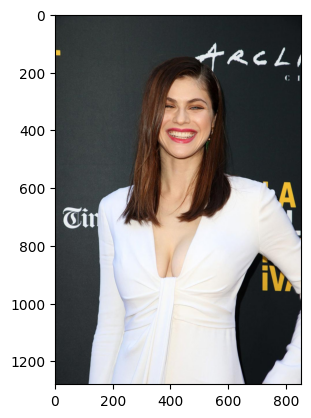

In [ ]:
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
plt.imshow(img)


# New Section

In [ ]:
from mtcnn.mtcnn import MTCNN

detector = MTCNN()
results = detector.detect_faces(img)

# New Section

In [ ]:
results


[{'box': [356, 217, 183, 267],
  'confidence': 0.9938191771507263,
  'keypoints': {'nose': [434, 372],
   'mouth_right': [490, 407],
   'right_eye': [485, 323],
   'left_eye': [396, 320],
   'mouth_left': [389, 404]}}]

In [ ]:
x,y,w,h = results[0]['box']

# New Section

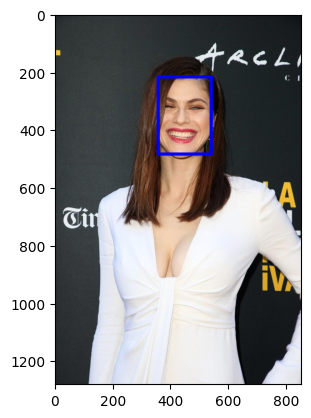

In [ ]:
img = cv.rectangle(img, (x,y), (x+w, y+h), (0,0,255), 10)
plt.imshow(img)

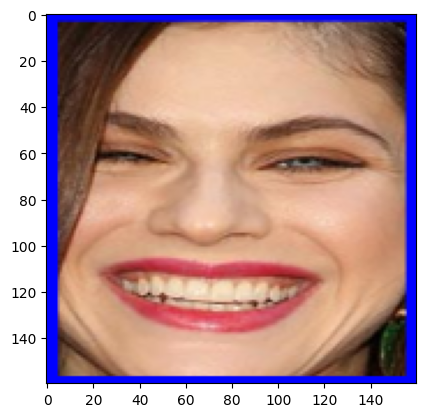

In [ ]:
my_face = img[y:y+h, x:x+w]
#facenet takes as input 160 x 160
my_face = cv.resize(my_face, (160,160))
plt.imshow(my_face)

# New Section

array([[[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       ...,

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]]], dtype=uint8)
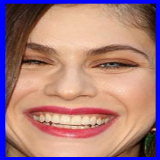

In [ ]:
my_face

Automate the Preprocessing

In [ ]:
import numpy as np
class FACELOADING:
    def __init__(self, directory): # Corrected constructor name
        self.directory = directory
        self.target_size = (160,160)
        self.X = []
        self.Y = []
        self.detector = MTCNN()

    def extract_face(self, filename):
        img = cv.imread(filename)
        img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
        x,y,w,h = self.detector.detect_faces(img)[0]['box']
        x,y = abs(x), abs(y)
        face = img[y:y+h, x:x+w]
        face_arr = cv.resize(face, self.target_size)
        return face

    def load_faces(self,dir):
        FACES = []
        for im_name in os.listdir(dir):
            try:
                path = dir + im_name
                single_face = self.extract_face(path)
                FACES.append(single_face)
            except Exception as e:
                pass
        return FACES

    def load_classes(self): # Assuming you meant 'load_classes' here
        for sub_dir in os.listdir(self.directory):
            path = self.directory + '/' + sub_dir + '/'
            FACES = self.load_faces(path)
            labels = [sub_dir for _ in range(len(FACES))]
            print(f"Loaded successfully: {len(labels)}")
            self.X.extend(FACES)
            self.Y.extend(labels)

        return np.asarray(self.X, dtype=object), np.asarray(self.Y)

    def plot_images(self):
        plt.figure(figsize=(18,16))
        for num,image in enumerate(self.X):
                ncols = 3
                nrows = len(self.Y)// ncols + 1
                plt.subplot(nrows,ncols,num+1)
                plt.imshow(image)
                plt.axis('off')



In [ ]:
faceloading = FACELOADING("/content/drive/MyDrive/Colab Notebooks/dataset")
X,Y = faceloading.load_classes()

Loaded successfully: 10
Loaded successfully: 10
Loaded successfully: 9
Loaded successfully: 10


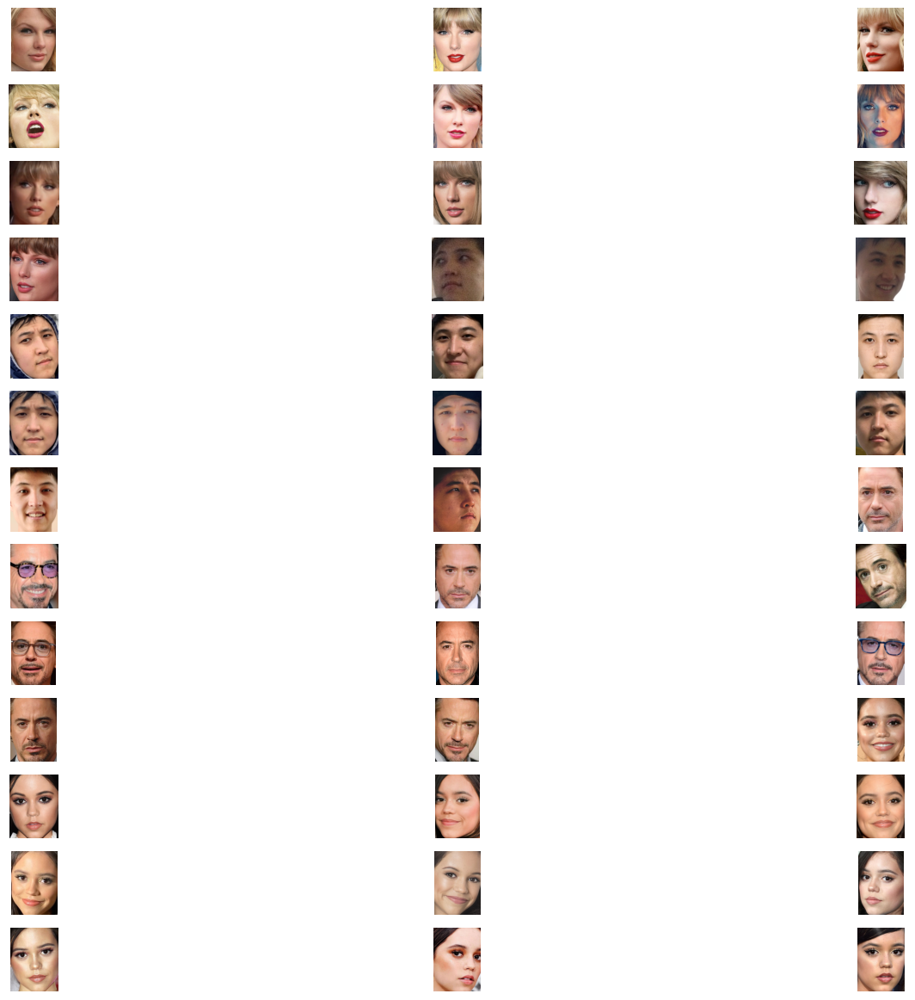

In [ ]:
plt.figure(figsize=(18,16))
for num,image in enumerate(X):
    ncols = 3
    nrows = len(Y)// ncols + 1
    plt.subplot(nrows,ncols,num+1)
    plt.imshow(image)
    plt.axis('off')

#FaceNet Part


In [ ]:
!pip install keras-facenet

In [ ]:
from keras_facenet import FaceNet
embedder = FaceNet()

def get_embedding(face_img):
    face_img = face_img.astype('float32')
    face_img = np.expand_dims(face_img, axis=0)
    yhat= embedder.embeddings(face_img)
    return yhat[0]

In [ ]:
EMBEDDED_X = []

for img in X:
    EMBEDDED_X.append(get_embedding(img))

EMBEDDED_X = np.asarray(EMBEDDED_X)

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 

In [ ]:
np.savez_compressed('faces_embeddings_done_4classes.npz', EMBEDDED_X, Y)

#SVM Model

In [ ]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
encoder.fit(Y)
Y = encoder.transform(Y)

In [ ]:
Y

array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [ ]:
from sklearn.model_selection import train_test_split

X_train,X_test, Y_train, Y_test = train_test_split(EMBEDDED_X, Y, shuffle=True, random_state=17)

In [ ]:
from sklearn.svm import SVC
model = SVC(kernel='linear', probability=True)
model.fit(X_train, Y_train)

SVC(kernel='linear', probability=True)

In [ ]:
ypreds_train = model.predict(X_train)
ypreds_test = model.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score

accuracy_score(Y_train, ypreds_train)

1.0

In [ ]:
accuracy_score(Y_test, ypreds_test)

1.0

In [ ]:
t_im = cv.imread("/content/drive/MyDrive/Colab Notebooks/sardor_test.jpg")
t_im = cv.cvtColor(t_im, cv.COLOR_BGR2RGB)
x,y,w,h = detector.detect_faces(t_im)[0]['box']

In [ ]:
t_im = t_im[y:y+h, x:x+w]
t_im = cv.resize(t_im, (160,160))
test_im = get_embedding(t_im)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


In [ ]:
test_im = [test_im]
ypreds = model.predict(test_im)

In [ ]:
ypreds

array([2])

In [ ]:
encoder.inverse_transform(ypreds)

array(['sardor_abdirayimov'], dtype='<U18')

Facr Recognition part2

In [ ]:
import cv2 as cv
import numpy as np
import os
import matplotlib.pyplot as plt
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import tensorflow as tf
import pickle
from sklearn.preprocessing import LabelEncoder
from keras_facenet import FaceNet
from google.colab.patches import cv2_imshow


INITAILIZE

--2024-10-19 10:13:32--  https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 930127 (908K) [text/plain]
Saving to: ‘haarcascade_frontalface_default.xml.13’

haarcascade_frontal 100%[===================>] 908.33K  --.-KB/s    in 0.06s   

2024-10-19 10:13:32 (15.5 MB/s) - ‘haarcascade_frontalface_default.xml.13’ saved [930127/930127]



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:376: InconsistentVersionWarning: Trying to unpickle estimator SVC from version 1.0.2 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


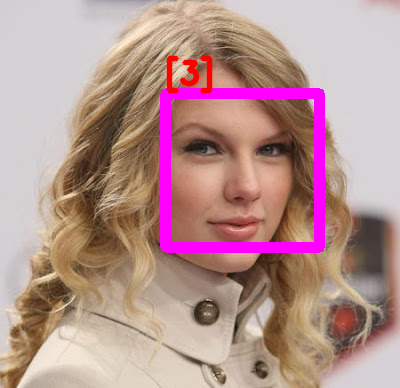

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


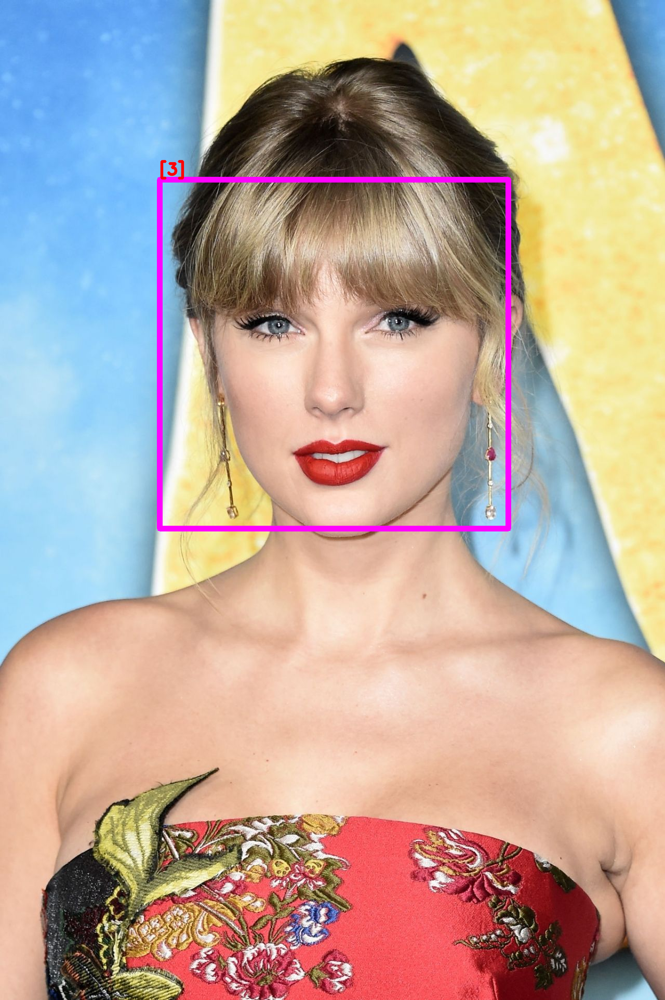

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


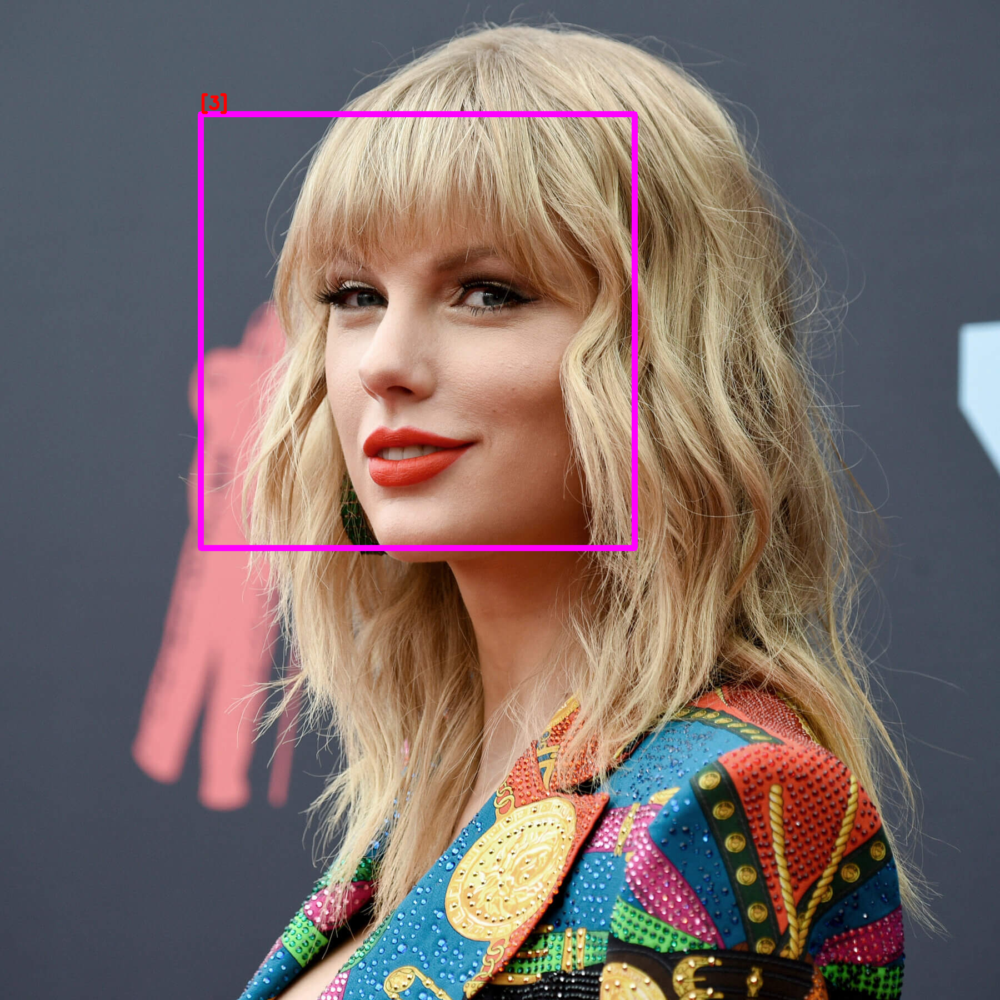

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


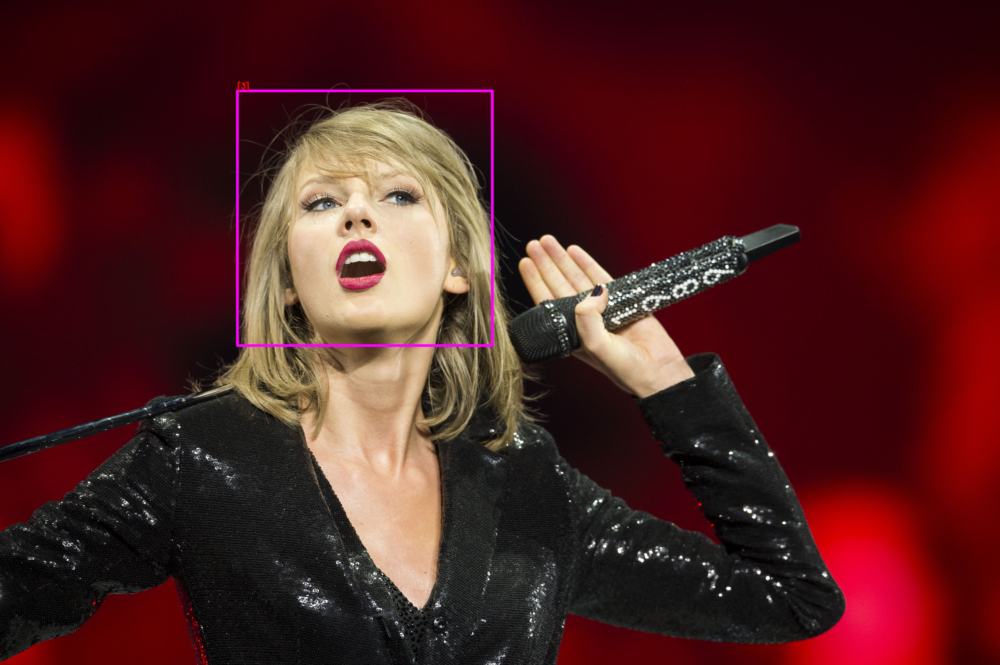

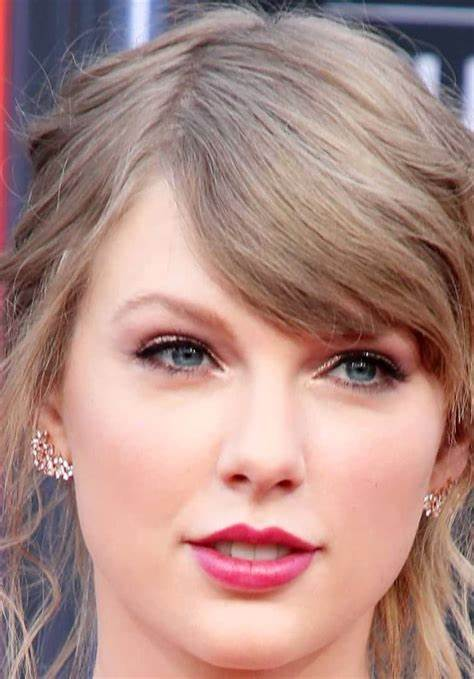

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


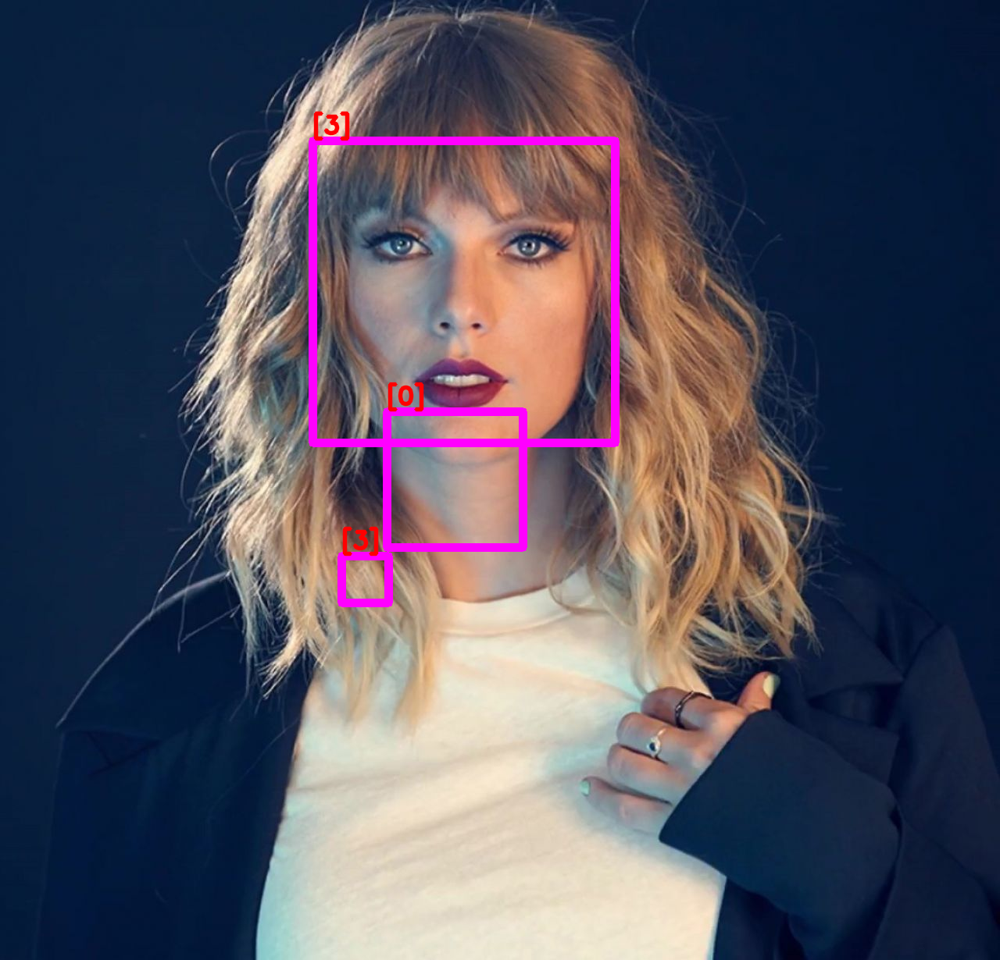

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


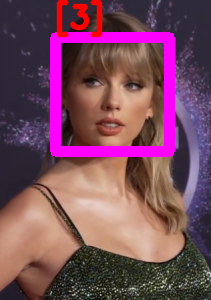

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


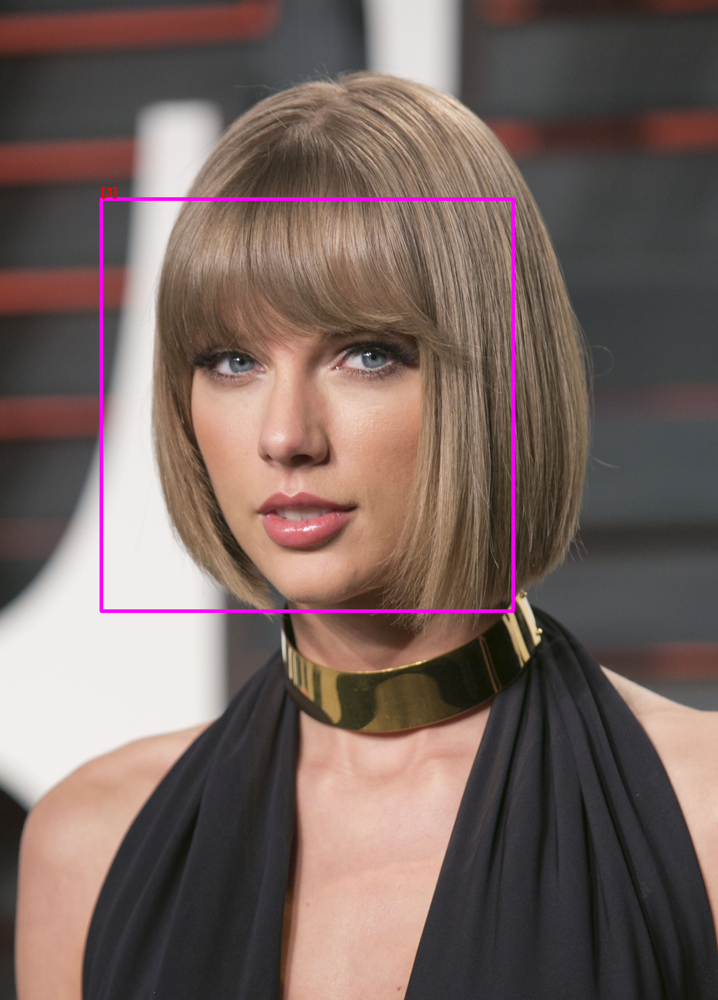

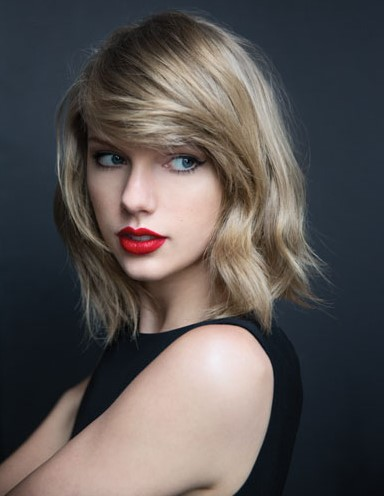

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


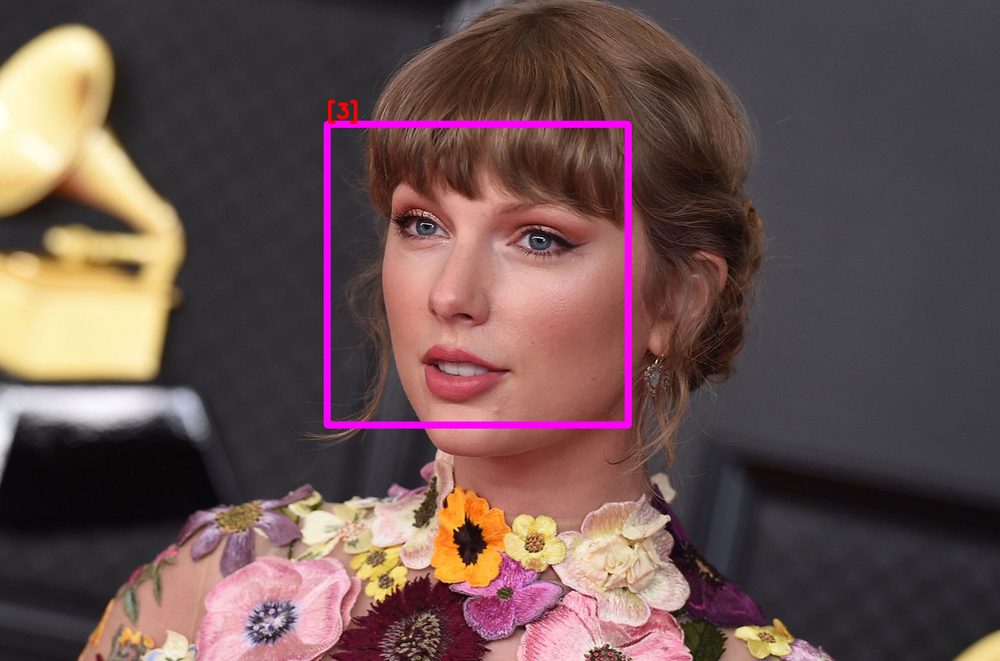

In [ ]:
!wget https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml

facenet = FaceNet()
face_embeddings = np.load("faces_embeddings_done_4classes.npz")
Y = face_embeddings['arr_1']
encoder = LabelEncoder()
encoder.fit(Y)
haarcascade = cv.CascadeClassifier("haarcascade_frontalface_default.xml")

# Load the model
try:
    model = pickle.load(open("/content/drive/MyDrive/Colab Notebooks/svm_model_160x160.pkl", "rb"))
except FileNotFoundError:
    print(f"Error: File not found at. Please check the file path.")
    # Handle the error appropriately, e.g., exit the program or use a default model


# Specify the directory containing your images
image_dir = "/content/drive/MyDrive/Colab Notebooks/dataset/taylor_swift"  # Replace with the actual path

# Loop through each image in the directory
for filename in os.listdir(image_dir):
    if filename.endswith((".jpg", ".jfif", ".png")):  # Adjust file extensions as needed
        image_path = os.path.join(image_dir, filename)
        frame = cv.imread(image_path)

        rgb_img = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
        gray_img = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)
        faces = haarcascade.detectMultiScale(gray_img, 1.3, 5)

        for x, y, w, h in faces:
            img = rgb_img[y:y + h, x:x + w]
            img = cv.resize(img, (160, 160))
            img = np.expand_dims(img, axis=0)
            ypred = facenet.embeddings(img) # Correct embeddeings to embeddings
            face_name = model.predict(ypred)
            final_name = encoder.inverse_transform(face_name)
            cv.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 255), 10)
            cv.putText(frame, str(final_name), (x, y - 10), cv.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 3, cv.LINE_AA)

        # Display the image with detections
        cv2_imshow(frame)
        cv.waitKey(0)  # Wait for a key press before moving to the next image
        cv.destroyAllWindows()

While Loop

In [ ]:
import cv2 as cv
while cap.isOpened():
   _, frame = cap.read()
   rgb_img = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
   gray_img = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)
   faces = haarcascade.detectMultiScale(gray_img, 1.3, 5)
   for x,y,w,h in faces:
       img = rgb_img[y:y+h, x:x+w]
       img = cv.resize(img, (160,160)) #1x160x160x3
       img = np.expand_dims(img, axis=0)
       ypred = facenet.embeddeings(img)
       face_name = model.predict(ypred)
       final_name = encoder.inverse_transform(face_name)
       cv.rectangle(frame, (x,y), (x+w, y+h), (255,0,255), 10)
       cv.putText(frame, str(final_name), (x,y-10), cv.FONT_HERSHEY_SIMPLEX, 1, (0,0,255), 3, cv.LINE_AA)


    # Corrected indentation for the following lines:
   cv.imshow("Face Recognition", frame)
   if cv.waitKey(1) & 0xFF == 27:
        break

cap.release()
cv.destroyAllWindows()





In [101]:
!git

usage: git [--version] [--help] [-C <path>] [-c <name>=<value>]
           [--exec-path[=<path>]] [--html-path] [--man-path] [--info-path]
           [-p | --paginate | -P | --no-pager] [--no-replace-objects] [--bare]
           [--git-dir=<path>] [--work-tree=<path>] [--namespace=<name>]
           [--super-prefix=<path>] [--config-env=<name>=<envvar>]
           <command> [<args>]

These are common Git commands used in various situations:

start a working area (see also: git help tutorial)
   clone     Clone a repository into a new directory
   init      Create an empty Git repository or reinitialize an existing one

work on the current change (see also: git help everyday)
   add       Add file contents to the index
   mv        Move or rename a file, a directory, or a symlink
   restore   Restore working tree files
   rm        Remove files from the working tree and from the index

examine the history and state (see also: git help revisions)
   bisect    Use binary search to find th

In [102]:
!git init

hint: Using 'master' as the name for the initial branch. This default branch name
hint: is subject to change. To configure the initial branch name to use in all
hint: of your new repositories, which will suppress this warning, call:
hint: 
hint: 	git config --global init.defaultBranch <name>
hint: 
hint: Names commonly chosen instead of 'master' are 'main', 'trunk' and
hint: 'development'. The just-created branch can be renamed via this command:
hint: 
hint: 	git branch -m <name>
Initialized empty Git repository in /content/.git/
